# IU2FRL & IU3GNB AI Denoiser

In [1]:
import numpy as np
import csv
import pydub 
import scipy
from IPython.display import Audio


# Custom test with MP3

## Download audio sample with WGET

In [2]:
!wget -O acdc.mp3 https://www.cjoint.com/doc/19_06/IFunxT17Z7p_acdc-back-in-black-official-music-video.mp3

--2023-08-07 09:59:05--  https://www.cjoint.com/doc/19_06/IFunxT17Z7p_acdc-back-in-black-official-music-video.mp3
Resolving www.cjoint.com (www.cjoint.com)... 51.159.102.213
Connecting to www.cjoint.com (www.cjoint.com)|51.159.102.213|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 7786855 (7.4M) [audio/mpeg]
Saving to: ‘acdc.mp3’

acdc.mp3            100%[===================>]   7.43M  33.2MB/s    in 0.2s    

2023-08-07 09:59:05 (33.2 MB/s) - ‘acdc.mp3’ saved [7786855/7786855]



## MP3 Modulation and demodulation

In [3]:
!pip install pydub numpy scipy

### Read MP3 function

In [4]:
def read(f, normalized=False):
    a = pydub.AudioSegment.from_mp3(f)
    y = np.array(a.get_array_of_samples())
    if a.channels == 2:
        y = y.reshape((-1, 2))
    if normalized:
        return a.frame_rate, np.float32(y) / 2**15
    else:
        return a.frame_rate, y

### LSB demodulator function

In [5]:
def lsb_demodulator(cutoff_freq, sampling_rate, modulated_signal, carrier_freq, duration):
    
    t = np.linspace(0, duration, int(sampling_rate * duration), endpoint=False)

    carrier = np.cos(2 * np.pi * carrier_freq * t)
    demodulated_signal = modulated_signal * (2 * carrier)
    
    b, a = scipy.signal.butter(6, cutoff_freq / (0.5 * sampling_rate), btype='low')
    recovered_signal = scipy.signal.lfilter(b, a, demodulated_signal)
    return recovered_signal

### FFT function

In [35]:
import matplotlib.pyplot as plt
def draw_fft(input_data, sampling_rate, title = "FFT of given signal"):
    num_samples = len(input_data)
    duration = num_samples/sampling_rate
    fft_result = np.fft.fft(input_data)
    freq_axis = np.fft.fftfreq(num_samples, d=1/sampling_rate)
    
    # Plot the magnitude spectrum
    plt.figure(figsize=(10, 6))
    plt.plot(freq_axis, np.abs(fft_result))
    plt.title(title)
    plt.xlabel("Frequency (Hz)")
    plt.ylabel("Magnitude")
    plt.grid()
    plt.show()

### Read MP3 and convert to Numpy array

In [19]:
tmp = read('acdc.mp3')
sampling_rate = tmp[0]
audio = tmp[1][:,0]
print("Sampling rate: " + str(sampling_rate))
print("Samples: " + str(len(audio)))

Sampling rate: 48000
Samples: 12215866


### FFT of input MP3

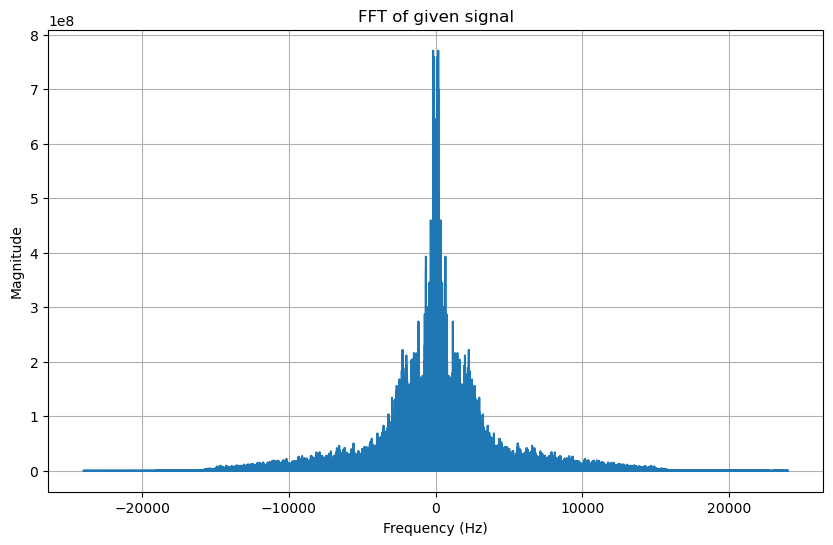

In [34]:
# Perform FFT
draw_fft(audio, sampling_rate)

### Modulate to LSB signal

In [26]:
# Parameters
carrier_freq = 400e3 # Carrier frequency in Hz
duration = audio.shape[0]*(1/sampling_rate)  # Duration of the signal in seconds
# Time array
t = np.linspace(0, duration, int(sampling_rate * duration), endpoint=False)

# Modulated signal
carrier = np.cos(2 * np.pi * carrier_freq * t)
modulated_signal = carrier * audio

noise = 10*np.random.normal(0,1,modulated_signal.shape[0])

channel_out = modulated_signal + noise

### FFT of LSB signal

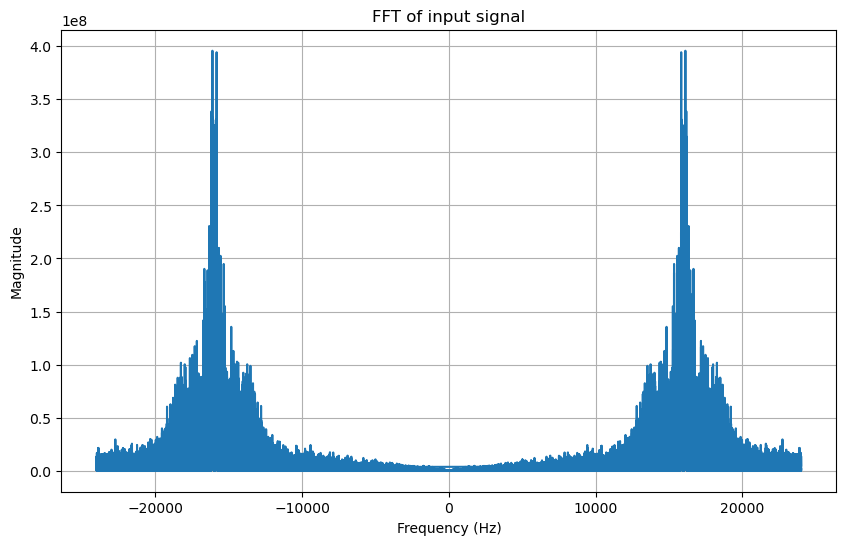

In [27]:
# Perform FFT
draw_fft(modulated_signal, sampling_rate)

### Demodulate LSB

In [31]:
result = lsb_demodulator(sampling_rate/4,sampling_rate,modulated_signal,carrier_freq,duration)

### Return audio

In [32]:
# Play the audio
Audio(data=result, rate=sampling_rate)

### FFT of demodulated signal

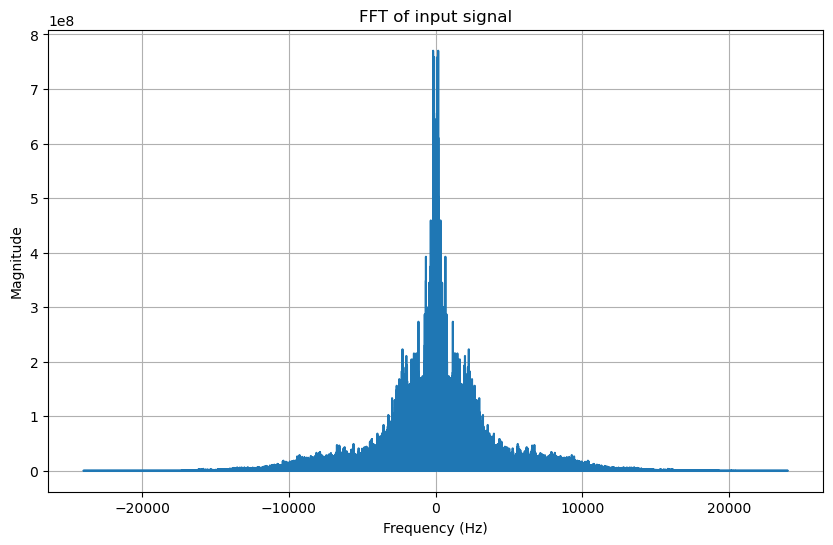

In [30]:
# Perform FFT
draw_fft(result, sampling_rate)